In [1]:
using MendelKinship, CSV, DataFrames

#output for openmendel
# open_mendel_output = Kinship("control10c.txt")
open_mendel_output = Kinship("control23a.txt")


# output of Mendel with ran with settings: 
# MODEL = 1
# MIN_MAF = 0.01
# KINSHIP_SOURCE = SNPs_with_everyone
# SNP_SAMPLING_INCREMENT = 1
# mendel_output = readdlm("Summary10c.out", header = true)
mendel_output = readdlm("Summary23a.out", header = true)


# convert everything to dataframe, easier to work with
mendel_output_df = convert(DataFrame, mendel_output[1])
rename!(mendel_output_df, f => t for (f, t) = 
    zip([:x1, :x2, :x3, :x4, :x5, :x6], 
        [:Pedigree1, :Person1, :Pedigree2, 
        :Person2, :expected_kinship, :empiric_kinship]))

INFO: Recompiling stale cache file /Users/biona001/.julia/lib/v0.6/CodecZlib.ji for module CodecZlib.
INFO: Recompiling stale cache file /Users/biona001/.julia/lib/v0.6/DataFrames.ji for module DataFrames.
INFO: Recompiling stale cache file /Users/biona001/.julia/lib/v0.6/CSV.ji for module CSV.
INFO: Recompiling stale cache file /Users/biona001/.julia/lib/v0.6/GLM.ji for module GLM.


 
 
     Welcome to OpenMendel's
     Kinship analysis option
        version 0.1.0
 
 
Reading the data.

The current working directory is "/Users/biona001/.julia/v0.6/MendelKinship/test".

Keywords modified by the user:

  compare_kinships = true
  control_file = control23a.txt
  field_separator = ,
  maf_threshold = 0.01
  pedigree_file = Ped23a.in
  snpdata_file = SNP_data23a.bed
  snpdefinition_file = SNP_def23a.txt
 


Stacktrace:
 [1] depwarn(::String, ::Symbol) at ./deprecated.jl:70
 [2] #readtable#233(::Bool, ::Char, ::Array{Char,1}, ::Char, ::Array{String,1}, ::Array{String,1}, ::Array{String,1}, ::Bool, ::Int64, ::Array{Symbol,1}, ::Array{Any,1}, ::Bool, ::Char, ::Bool, ::Int64, ::Array{Int64,1}, ::Bool, ::Symbol, ::Bool, ::Bool, ::DataFrames.#readtable, ::SubString{String}) at /Users/biona001/.julia/v0.6/DataFrames/src/deprecated.jl:1050
 [3] (::DataFrames.#kw##readtable)(::Array{Any,1}, ::DataFrames.#readtable, ::SubString{String}) at ./<missing>:0
 [4] read_external_data_files(::Dict{AbstractString,Any}) at /Users/biona001/.julia/v0.6/MendelBase/src/read_data.jl:70
 [5] #Kinship#1(::Array{Any,1}, ::Function, ::String) at /Users/biona001/.julia/v0.6/MendelKinship/src/MendelKinship.jl:75
 [6] Kinship(::String) at /Users/biona001/.julia/v0.6/MendelKinship/src/MendelKinship.jl:27
 [7] include_string(::String, ::String) at ./loading.jl:515
 [8] include_string(::Module, ::String, ::String) at /User

 
Analyzing the data.



,Pedigree1,Person1,Pedigree2,Person2,expected_kinship,empiric_kinship,x7
1,PED054,431,PED054,430,0.0,--,
2,PED054,431,PED054,431,0.5,--,
3,PED054,412,PED054,430,0.25,--,
4,PED054,412,PED054,431,0.25,--,
5,PED054,412,PED054,412,0.5,--,
6,PED058,438,PED054,430,0.0,0.00128,
7,PED058,438,PED054,431,0.0,--,
8,PED058,438,PED054,412,0.0,--,
9,PED058,438,PED058,438,0.5,0.65879,
10,PED058,444,PED054,430,0.0,--,


In [2]:
#extract rows with Pedigree1 == "1"
y = open_mendel_output[open_mendel_output[:, 1] .== "17", :]

#extract rows with Pedigree2 == "2"
y = y[y[:, 2] .== "17", :]

#sort by Person1
sort!(y, cols = (:Person1))

#extract rows with Pedigree1 = j
#z = mendel_output_df[mendel_output_df[:, 1] .== 1.0, :]

#extract rows with Pedigree2 = j
#z = z[z[:, 3] .== 1.0, :]


,Pedigree1,Pedigree2,Person1,Person2,theoretical_kinship,empiric_kinship


### Compare mendel and open mendel by constructing convenient dataframe

In [3]:
compare = DataFrame(
    Person1 = String[], 
    Person2 = String[], 
    Mendel_empiric= Float64[], 
    OpenMendel_empiric=Float64[],
    Mendel_theoretical=Float64[],
    OpenMendel_theoretical=Float64[])

m = size(mendel_output_df, 1)

for i in 1:m
    cur_row = mendel_output_df[i, :]
    if cur_row[6][1] == "--"
        continue
    end
    
    person1 = string(Int64(cur_row[2][1]))
    person2 = string(Int64(cur_row[4][1]))

    y = copy(open_mendel_output)
        
    #find rows with Person1 = person1
    y = y[y[:, 3] .== person1, :]

    #find rows with Person2 = person2
    y = y[y[:, 4] .== person2, :]
    
    if size(y, 1) == 0
        continue
    end

    push!(compare, [person1, person2, cur_row[6][1], 
                y[6][1], cur_row[5][1], y[5][1]])
end

In [4]:
compare

,Person1,Person2,Mendel_empiric,OpenMendel_empiric,Mendel_theoretical,OpenMendel_theoretical
1,438,430,0.00128,0.0220543,0.0,0.0
2,438,438,0.65879,0.45972,0.5,0.5
3,513,430,0.15181,0.0063139,0.0,0.0
4,513,438,0.0,-0.0719795,0.0,0.0
5,513,513,0.5,0.160663,0.5,0.5
6,1011,430,0.76998,0.242141,0.0,0.0
7,1011,438,0.0,-0.0656295,0.0,0.0
8,1011,513,0.58413,0.134577,0.0,0.0
9,1011,1011,1.0,0.991397,0.5,0.5
10,741,430,0.0,0.059904,0.0,0.0


In [5]:
#check the answer is correct

#find a specific person in Mendel's output
z = mendel_output_df[mendel_output_df[:, 2] .== "133432", :]
z = z[z[:, 4] .== "133432", :]
println(z[3:6])

#find a specific person in Open Mendel's output
y = open_mendel_output[open_mendel_output[:, 3] .== "133432", :]
y = y[y[:, 4] .== "133432", :]

0×4 DataFrames.DataFrame



,Pedigree1,Pedigree2,Person1,Person2,theoretical_kinship,empiric_kinship


### See if Mendel and Open Mendel agree in theoretical kinship coeff

In [6]:
theoretical_error = compare[:, 5] - compare[:, 6]
sum(theoretical_error)


0.0

### Check how the theoretical and empirical between mendel and open mendel compares

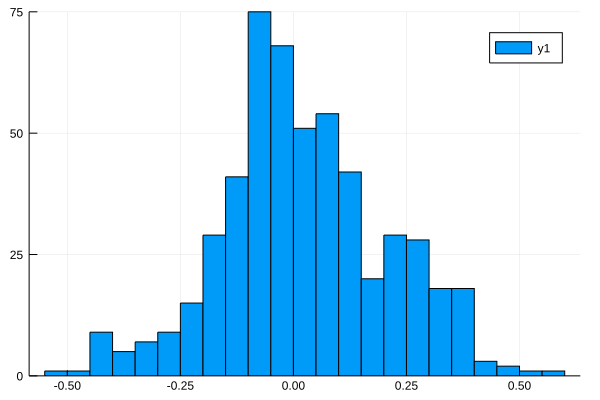

In [7]:
using Plots
gr()

#theoreical vs Open Mendel empirical
histogram(compare[:, 4] - compare[:, 6])

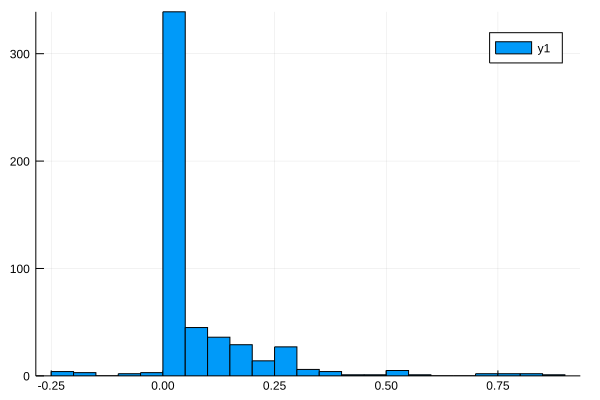

In [8]:
#Mendel empirical vs theoretical 
histogram(compare[:, 3] - compare[:, 5])

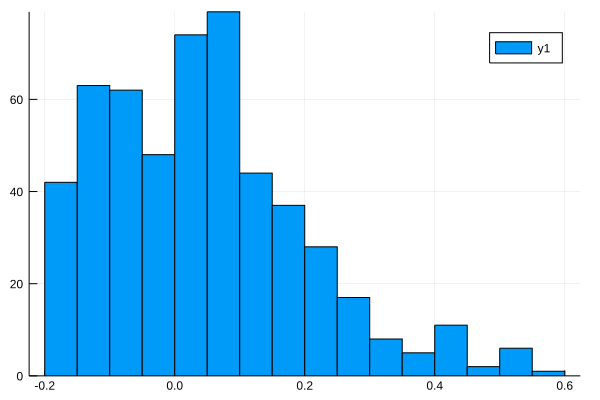

In [9]:
#open mendel empirical vs mendel empirical
histogram(compare[:, 3] - compare[:, 4])

In [10]:
# find large deviations
huge_deviations = DataFrame(Person1 = String[], Person2 = String[], 
    Mendel_empiric= Float64[], 
    OpenMendel_empiric=Float64[],theoretical=Float64[])

m = size(compare, 1)

for i in 1:m
    cur_row = compare[i, :]
    cur_row = [cur_row[1][1], cur_row[2][1], cur_row[3][1], 
        cur_row[4][1], cur_row[6][1]]
    if abs(cur_row[5] - cur_row[4]) >= 0.05
        push!(huge_deviations, cur_row)
    end
end

In [11]:
huge_deviations #difference >= 0.05

,Person1,Person2,Mendel_empiric,OpenMendel_empiric,theoretical
1,513,438,0.0,-0.0719795,0.0
2,513,513,0.5,0.160663,0.5
3,1011,430,0.76998,0.242141,0.0
4,1011,438,0.0,-0.0656295,0.0
5,1011,513,0.58413,0.134577,0.0
6,1011,1011,1.0,0.991397,0.5
7,741,430,0.0,0.059904,0.0
8,741,438,0.0,0.0620826,0.0
9,741,1011,0.0,-0.384519,0.0
10,741,741,0.5,0.422854,0.5


In [12]:
println(size(compare))
println(size(huge_deviations))
huge_deviations

(527, 6)
(408, 5)


,Person1,Person2,Mendel_empiric,OpenMendel_empiric,theoretical
1,513,438,0.0,-0.0719795,0.0
2,513,513,0.5,0.160663,0.5
3,1011,430,0.76998,0.242141,0.0
4,1011,438,0.0,-0.0656295,0.0
5,1011,513,0.58413,0.134577,0.0
6,1011,1011,1.0,0.991397,0.5
7,741,430,0.0,0.059904,0.0
8,741,438,0.0,0.0620826,0.0
9,741,1011,0.0,-0.384519,0.0
10,741,741,0.5,0.422854,0.5


In [13]:
using MendelKinship
x = Kinship("control23a.txt")
name = Array{String}(size(x, 1))
for i in 1:length(name)
    name[i] = x[i, 3] * " \& " * x[i, 4]
end


 
 
     Welcome to OpenMendel's
     Kinship analysis option
        version 0.1.0
 
 
Reading the data.

The current working directory is "/Users/biona001/.julia/v0.6/MendelKinship/test".

Keywords modified by the user:

  compare_kinships = true
  control_file = control23a.txt
  field_separator = ,
  maf_threshold = 0.01
  pedigree_file = Ped23a.in
  snpdata_file = SNP_data23a.bed
  snpdefinition_file = SNP_def23a.txt
 


Stacktrace:
 [1] depwarn(::String, ::Symbol) at ./deprecated.jl:70
 [2] #readtable#233(::Bool, ::Char, ::Array{Char,1}, ::Char, ::Array{String,1}, ::Array{String,1}, ::Array{String,1}, ::Bool, ::Int64, ::Array{Symbol,1}, ::Array{Any,1}, ::Bool, ::Char, ::Bool, ::Int64, ::Array{Int64,1}, ::Bool, ::Symbol, ::Bool, ::Bool, ::DataFrames.#readtable, ::SubString{String}) at /Users/biona001/.julia/v0.6/DataFrames/src/deprecated.jl:1050
 [3] (::DataFrames.#kw##readtable)(::Array{Any,1}, ::DataFrames.#readtable, ::SubString{String}) at ./<missing>:0
 [4] read_external_data_files(::Dict{AbstractString,Any}) at /Users/biona001/.julia/v0.6/MendelBase/src/read_data.jl:70
 [5] #Kinship#1(::Array{Any,1}, ::Function, ::String) at /Users/biona001/.julia/v0.6/MendelKinship/src/MendelKinship.jl:75
 [6] Kinship(::String) at /Users/biona001/.julia/v0.6/MendelKinship/src/MendelKinship.jl:27
 [7] include_string(::String, ::String) at ./loading.jl:515
 [8] include_string(::Module, ::String, ::String) at /User

 
Analyzing the data.



readtable is deprecated, use CSV.read from the CSV package instead
Stacktrace:
 [1] depwarn(::String, ::Symbol) at ./deprecated.jl:70
 [2] #readtable#233(::Bool, ::Char, ::Array{Char,1}, ::Char, ::Array{String,1}, ::Array{String,1}, ::Array{String,1}, ::Bool, ::Int64, ::Array{Symbol,1}, ::Array{Any,1}, ::Bool, ::Char, ::Bool, ::Int64, ::Array{Int64,1}, ::Bool, ::Symbol, ::Bool, ::Bool, ::DataFrames.#readtable, ::SubString{String}) at /Users/biona001/.julia/v0.6/DataFrames/src/deprecated.jl:1050
 [3] (::DataFrames.#kw##readtable)(::Array{Any,1}, ::DataFrames.#readtable, ::SubString{String}) at ./<missing>:0
 [4] read_external_data_files(::Dict{AbstractString,Any}) at /Users/biona001/.julia/v0.6/MendelBase/src/read_data.jl:125
 [5] #Kinship#1(::Array{Any,1}, ::Function, ::String) at /Users/biona001/.julia/v0.6/MendelKinship/src/MendelKinship.jl:75
 [6] Kinship(::String) at /Users/biona001/.julia/v0.6/MendelKinship/src/MendelKinship.jl:27
 [7] include_string(::String, ::String) at ./loadi

In [15]:
using Plots
plotlyjs()
scatter(x[:empiric_kinship], x[:theoretical_kinship],
    xlabel = "empiric kinship", ylabel = "theoretical kinship (θ)",
    hover = name)